# Explore the dataset


In this notebook, we will perform an EDA (Exploratory Data Analysis) on the processed Waymo dataset (data in the `processed` folder). In the first part, you will create a function to display 

In [2]:
import math
import random

import numpy as np
import cv2
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

from utils import get_dataset
%matplotlib inline

In [2]:
dataset = get_dataset("/app/project/data/processed/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/processed/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/processed/segment-10017090168044687777_6380_000_6400_000_with_camera_labels.tfrecord']
INFO:tensorflow:Number of filenames to read: 1
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.experimental_deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()


2022-04-05 10:25:07.435245: E tensorflow/stream_executor/cuda/cuda_driver.cc:328] failed call to cuInit: CUDA_ERROR_UNKNOWN: unknown error


## Write a function to display an image and the bounding boxes

Implement the `display_instances` function below. This function takes a batch as an input and display an image with its corresponding bounding boxes. The only requirement is that the classes should be color coded (eg, vehicles in red, pedestrians in blue, cyclist in green).

In [52]:
def display_instances(batch):
    """
    This function takes a batch from the dataset and display the image with 
    the associated bounding boxes.
    """
    # Define plot format based on the number of frames in the batch.
    N = len(list(batch))
    num_col = 7
    num_row = math.ceil(N / num_col)

    # Map the classes to RGB colors to show bounding boxes of vehicles, pedestrians, and cyclists in red, blue, and green, respectively. 
    colormap = {1:[1,0,0], 2:[0,0,1], 4:[0,1,0]}

    # Iterate the batch to show each image and bounding boxes.
    fig, axes = plt.subplots(num_row, num_col, figsize=(5*num_col, 5*num_row))
    i = 0
    for data in batch:
        # Extract necessary values from the dictionary data.
        img = data['image'].numpy()
        height = img.shape[0]
        width = img.shape[1]
        boxes = data['groundtruth_boxes'].numpy()
        classes = data['groundtruth_classes'].numpy()

        # Plot images.
        row = i//num_col
        col = i%num_col
        axes[row,col].imshow(img)
        
        # Plot bounding boxes using Rectangle class of matplotlib.
        # Note that the coordinates of the bounding boxes in the data are normalized. 
        for bb, cl in zip(boxes, classes):
            y1, y2 = bb[[0, 2]] * height
            x1, x2 = bb[[1, 3]] * width
            rec = Rectangle((x1, y1), x2-x1, y2-y1, edgecolor=colormap[cl], facecolor='none')
            axes[row,col].add_patch(rec)
        axes[row,col].axis('off')

        i += 1
    
    # Delete empty plots.
    for j in range(num_col*num_row - N):
        fig.delaxes(axes.flatten()[-(1+j)])

    plt.show()

## Display 10 images 

Using the dataset created in the second cell and the function you just coded, display 10 random images with the associated bounding boxes. You can use the methods `take` and `shuffle` on the dataset.

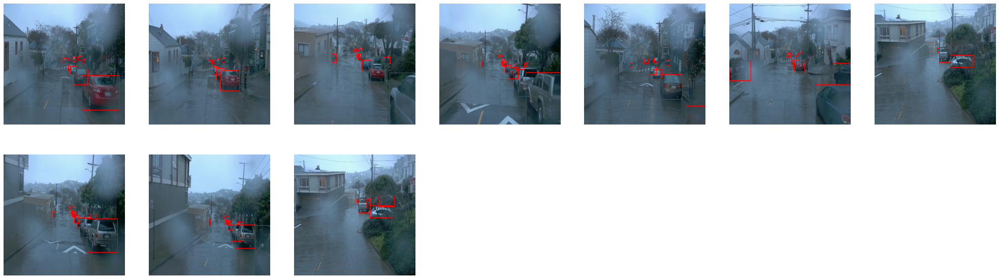

In [4]:
dataset = dataset.shuffle(buffer_size=1000, seed=42)
batch = dataset.take(10)
display_instances(batch)

## Additional EDA

In this last part, you are free to perform any additional analysis of the dataset. What else would like to know about the data?
For example, think about data distribution. So far, you have only looked at a single file...

## Strategy

To better undastand the data, I further analyze it and extract statistical information below.
- Number of the images
- Class distribution
- Basic properties of the images
- Environmental conditions in the images
- Object size distribution

### Number of the images

There are 100 .tfrecord files in total. First I count the total number of images contained in them to know how many images are available for training my objec detection model.

*NOTE: However, I've found it's impossible because of an infinite loop. When iterating the tensorflow Dataset object generated from the .tfrecord files, the iteration never ends. I have posted this issue to Knowledge and discussed it with a mentor. Although he/she has clarified the phenomenon is caused by the use of the waymo dataset, the issue hasn't been resolved yet. See https://knowledge.udacity.com/questions/826711 for details. I recommend the Udacity team mention this issue in the project description or fix it if possible.

In [3]:
dataset = get_dataset("/app/project/data/processed/*.tfrecord")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/processed/*.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/processed/*.tfrecord']
INFO:tensorflow:Number of filenames to read: 100
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.experimental_deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()


2022-04-09 11:01:17.867008: E tensorflow/stream_executor/cuda/cuda_driver.cc:328] failed call to cuInit: CUDA_ERROR_UNKNOWN: unknown error


In [12]:
# Following loop never ends, so do not execute it.

# N = 0
# for data in dataset:
#     N += 1
# print(N)

KeyboardInterrupt: 

Hereafter, I use a batch composed of 10,000 images which are randomly selected from the whole datast. Even though I have no information about the number of images in each .tfrecord file, it should be reasonable to assume one .tfrecord file contains at least 100 images.

There is no evidence that 10,000 images are enough to precisely represent statistical properties of the whole dataset. But this is EDA, whose purpose is to come up with a good strategy for the model training, so I believe some insights can be obtained from the batch investigation. 

### Class distribution

It's important to know distribution of classes among the data. With this information, we can check wether there is any biases in the data toward specific classes, which makes it difficult for the model to generalize well. I will consider suitable augmentations to the data based on the distribution.

In [72]:
dataset = get_dataset("/app/project/data/processed/*.tfrecord")
dataset = dataset.shuffle(1000, seed=42).take(10000)

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/processed/*.tfrecord']
INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/processed/*.tfrecord']
INFO:tensorflow:Number of filenames to read: 100


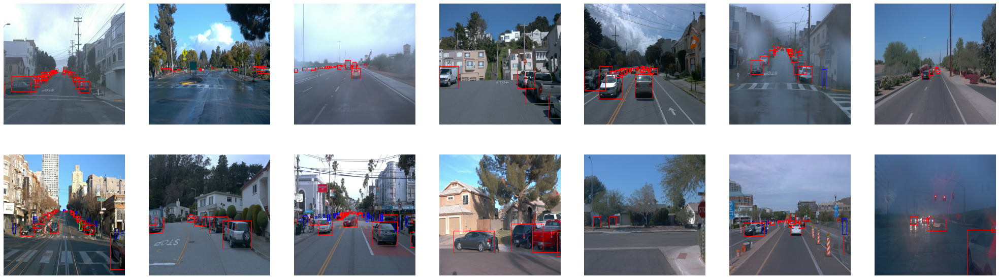

In [37]:
# Visual inspection
display_instances(dataset.take(14))

Vehicles: 179,433
Pedestrians: 52,146, Ratio to the vehicles: 0.2906154386316898
Cyclists: 1,322, Ratio to the vehicles: 0.007367652549976872


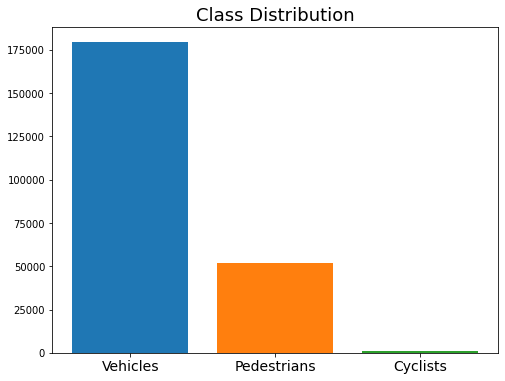

In [36]:
class_count = {1:0, 2:0, 4:0}   # {vehicles, pedestrians, cyclists}
for sample in dataset:
    classes = sample['groundtruth_classes'].numpy()
    for cl in classes:
        class_count[cl] += 1
print(f'Vehicles: {class_count[1]:,}')
print(f'Pedestrians: {class_count[2]:,}, Ratio to the vehicles: {class_count[2]/class_count[1]}')
print(f'Cyclists: {class_count[4]:,}, Ratio to the vehicles: {class_count[4]/class_count[1]}')

label_map = {1:'Vehicles', 2:'Pedestrians', 4:'Cyclists'}
fig, ax = plt.subplots(figsize=(8,6))
for i, cl in enumerate(class_count):
    ax.bar(i, class_count[cl])
ax.set_xticks([i for i, _ in enumerate(label_map)])
ax.set_xticklabels(list(label_map.values()), fontsize=14)
ax.set_title('Class Distribution', fontsize=18)
plt.show()

As shown above, vehicles is the dominant class in the data, which is consistent with the intuition from visual inspection. 
There are hundred times more object labeld as vehicles than those labeld cyclists. 
Therefore I should be careful about the imbalance between the classes when training the model to achieve good performance for cyclists as well as vehicles and pedestrians. 
I will augment the data to increase the number of objects labeld pedestrians or cyclists.

### Environmental conditions in the images

Visual inspection allows me to find that the images in the dataset differ from each other in many points.

Here I investigate following features to quantitatively understand the differences among the images:
1. Mean/Median Brightness
2. Image Contrast
3. Object Number/Density
4. Object Size/Shape 

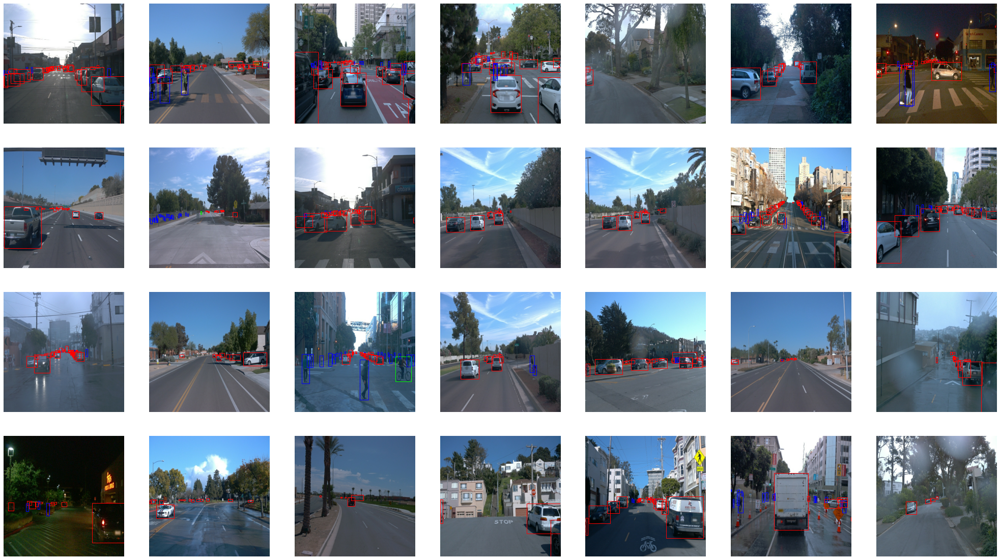

In [38]:
display_instances(dataset.take(28))

#### 1. Mean/Median Brightness

I expect mean brightness of the images to have information on the period of time in which they were taken. Images taken during daytime should be brighter on average than those taken at night. Hence I obtain approximate fractions of day/night images from the mean brightness distribution. I do the same analysis with median values as well to check if outliers in the night images, such as artificial lights, significantly affect the mean brightness.

In [101]:
mean_brightness = []
median_brightness = []
for data in dataset:
    img_rgb = data['image'].numpy()
    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    brightness = img_hsv[..., 2]
    mean_brightness.append(np.mean(brightness))
    median_brightness.append(np.median(brightness))

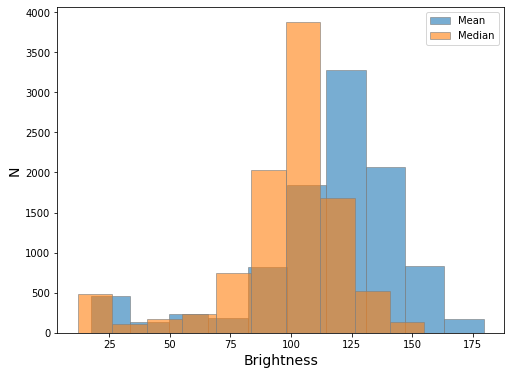

In [119]:
plt.figure(figsize=(8, 6))
mean_hist, mean_bins, _ = plt.hist(mean_brightness, alpha=0.6, edgecolor='gray', label='Mean')
med_hist, med_bins, _ = plt.hist(median_brightness, alpha=0.6, edgecolor='gray', label='Median')
plt.xlabel('Brightness', fontsize=14)
plt.ylabel('N', fontsize=14)
plt.legend()
plt.show()

It is shown in the figure that both distributions of mean or median brightness have similar shapes, but there is an offset between the peak positions. This suggesets that a small number of very bright pixels increase the mean values. 

However, it's not clear where the brightness criterion to distinguish daytime images from night ones. My first guess is that the peak value of the histogram can separate the images into the two groups. Test this hypothesis by visualizing images on the both sides of the peak.

In [161]:
# Get the left/right edges, and the center of the peak bin.
median_peak_left = med_bins[np.argmax(med_hist)]
median_peak_right = med_bins[np.argmax(med_hist)+1]
median_peak = (median_peak_left+median_peak_right) / 2

# Create sub-lists which store images within specific brightness intervals. 
darker_images = []
brighter_images = []
intermediate_images = []
for data in dataset:
    img_rgb = data['image'].numpy()
    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    brightness = img_hsv[..., 2]
    median = np.median(brightness)
    if median < median_peak_left: # Darker than the peak value.
        darker_images.append(img_rgb)
    elif median > median_peak_right: # Brighter.
        brighter_images.append(img_rgb)
    else: # Within the peak bin.
        intermediate_images.append(img_rgb)

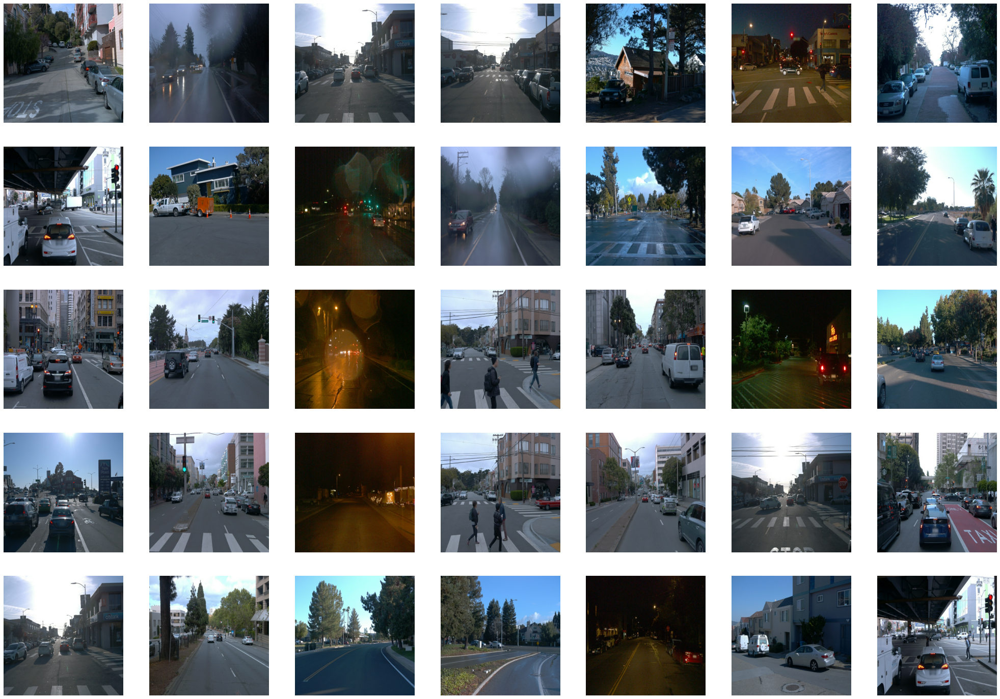

In [163]:
# Show darker images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(darker_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

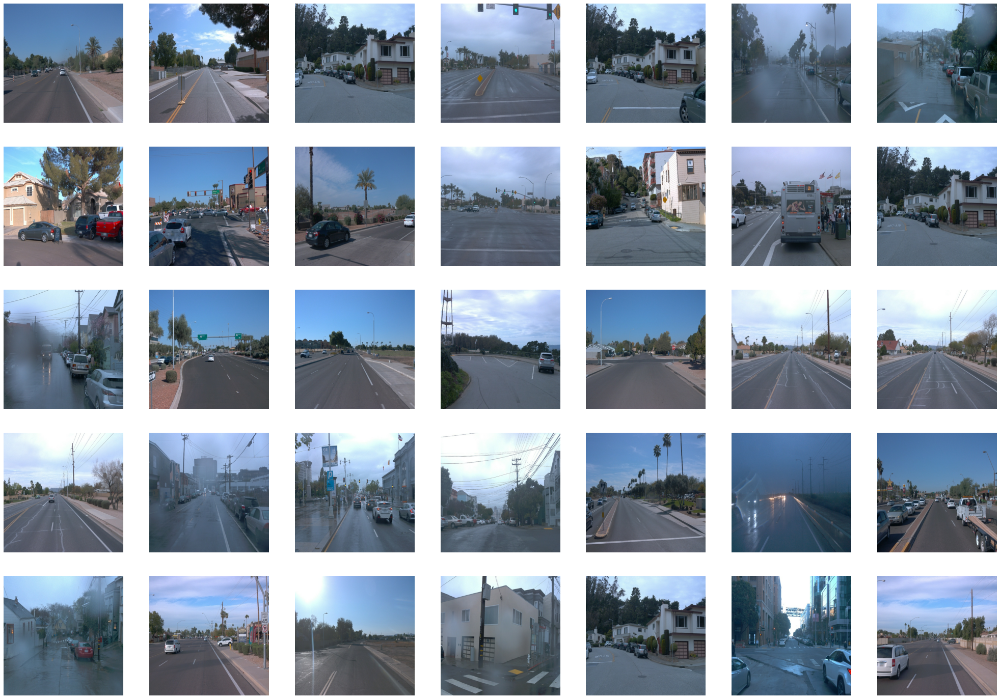

In [164]:
# Show brighter images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(brighter_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

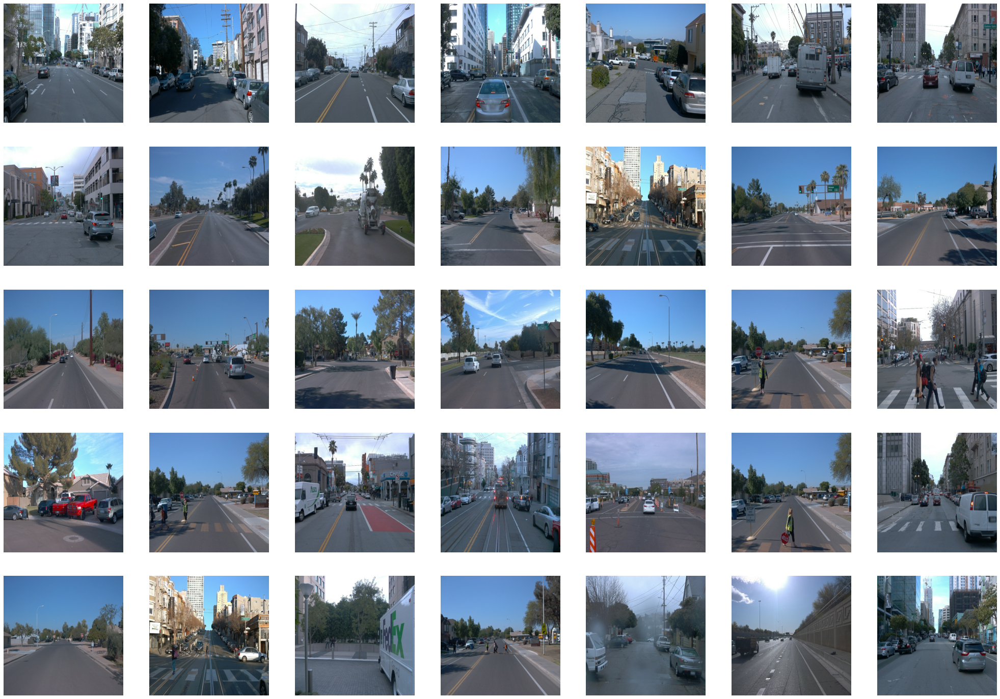

In [165]:
# Show intermediately bright images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(intermediate_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

Clearly "darker images" contain a lot of images taken during daytime. Therefore the peak median value of the histogram is not suitable for day/night separation. This is also implied by the fact that almost all of the "intermediate images" are those taken during daytime.

What if the criterion is shifted toward left?

In [170]:
# Same as the previous one, but shifting the criterion toward darker side.

# Get the left/right edges, and the center of the peak bin.
median_peak_left = med_bins[np.argmax(med_hist)-3]
median_peak_right = med_bins[np.argmax(med_hist)-2]
median_peak = (median_peak_left+median_peak_right) / 2

# Create sub-lists which store images within specific brightness intervals. 
darker_images = []
brighter_images = []
intermediate_images = []
for data in dataset:
    img_rgb = data['image'].numpy()
    img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    brightness = img_hsv[..., 2]
    median = np.median(brightness)
    if median < median_peak_left: # Darker than the peak value.
        darker_images.append(img_rgb)
    elif median > median_peak_right: # Brighter.
        brighter_images.append(img_rgb)
    else: # Within the peak bin.
        intermediate_images.append(img_rgb)

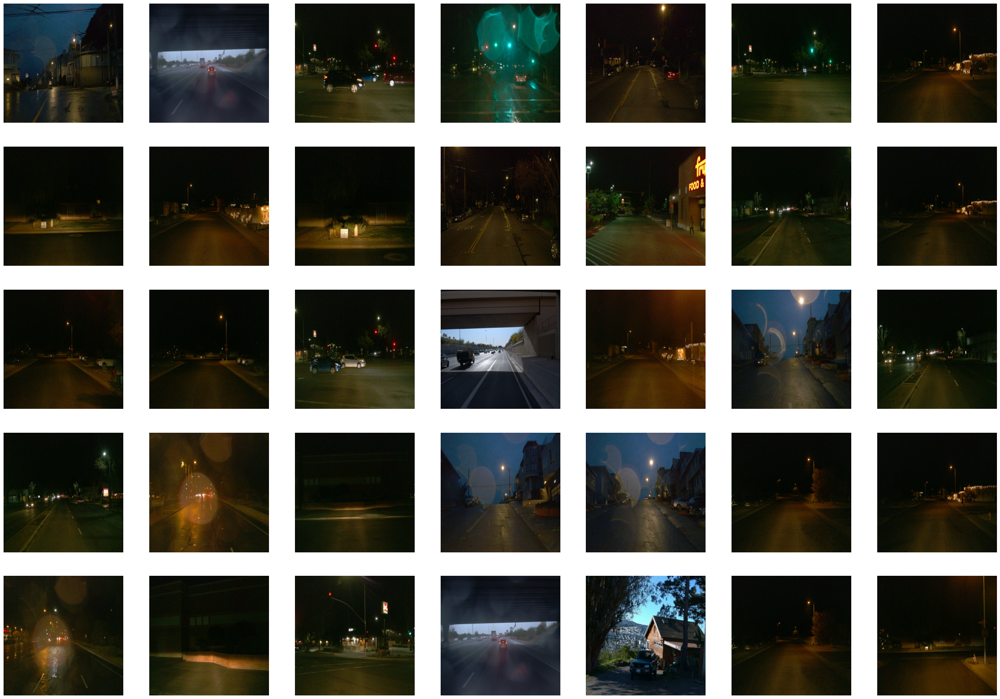

In [171]:
# Show darker images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(darker_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

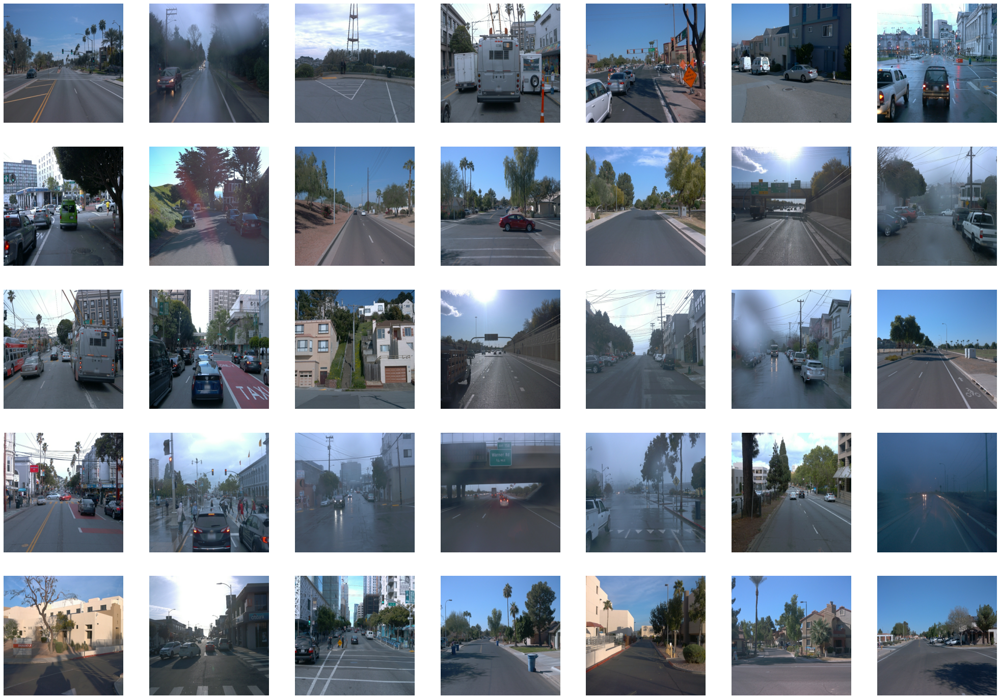

In [172]:
# Show brighter images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(brighter_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

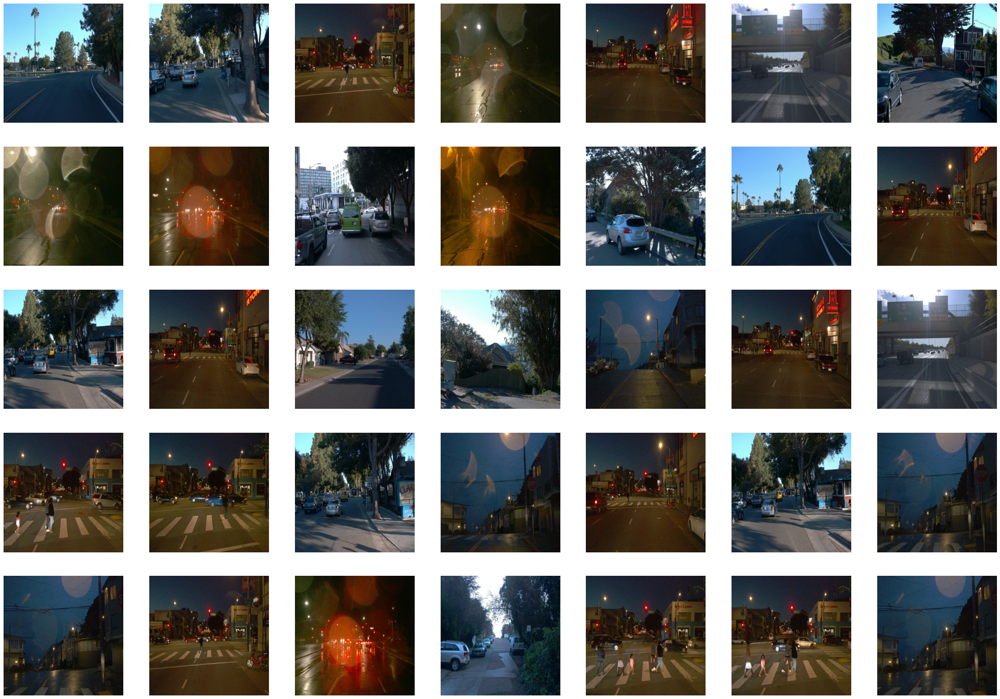

In [173]:
# Show intermediately bright images.
fig, axes = plt.subplots(5, 7, figsize=(35, 25))
for i in range(35):
    axes[i//7, i%7].imshow(intermediate_images[i])
    axes[i//7, i%7].axis('off')
plt.show()

It seems to be a better separation. "darker images" mainly consists of images taken at night, while "intermideate images" is a mixture of day/night images. With this result, I can reasonanly estimate the populations of day/night images, although more accurate separation requires more advanced analysis probably using information on image contrast, colors, and so on. Since the criterion used above separate the histogram into day side and night side, I count the number of images on both sides to get the number of members in each group.

In [199]:
# Count the number of day/night images by accumulating the histogram on both sides.
darker_idx = np.argmax(med_hist)-3
brighter_idx = np.argmax(med_hist)-2

N_night = sum(med_hist[0:darker_idx])
N_day = sum(med_hist[brighter_idx:])
N_intermediate = sum(med_hist[darker_idx:brighter_idx+1])

print(f"Daytime: {N_day:,.0f} images ({N_day/10000:.2%})")
print(f"Night: {N_night:,.0f} images ({N_night/10000:.2%})")
print(f"Intermediate: {N_intermediate:,.0f} images ({N_intermediate/10000:.2%})")

Daytime: 8,981 images (89.81%)
Night: 779 images (7.79%)
Intermediate: 987 images (9.87%)


It is also interesting that there are quite amount of extremely dark images, which compose $\sim$ 5% of the whole dataset.

#### 2. Image Contrast

Image contrast is a distinguising feature of images as well as brightness. It can be used as an indicator of weather cocnditions under which the images were taken. I expect high contrast between the blue sky and other objects for sunny images, while low values for cloudy, foggy or night images.

As contrast of an image is associated with the breadth of its pixel value distribution, I use standard deviation of brightnes distribution as a proxy of image contrast, though I'm not sure if this is the best practice. In the next cell, I examine individual samples randomly selected from the darker and brighter images to get an intuition about a contrast criterion which separates sunny images from the others.

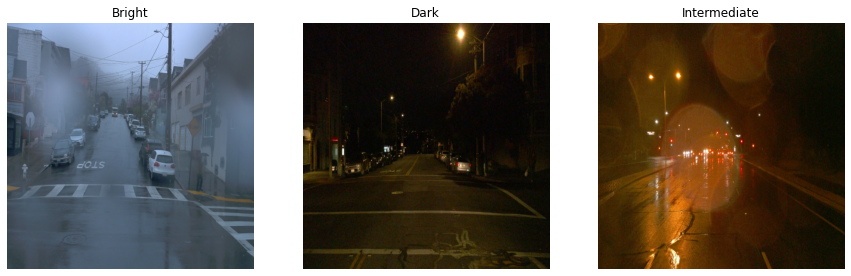

Bright: median = 113.00, stddev = 45.42
Dark: median = 21.00, stddev = 23.54
Intermediate: median = 63.00, stddev = 44.78


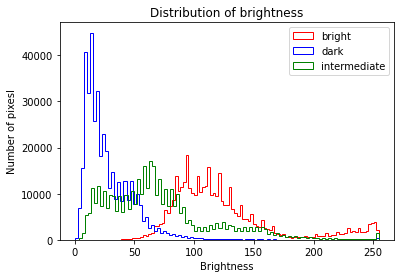

In [325]:
bright_image = random.choice(brighter_images)
dark_image = random.choice(darker_images)
intermediate_image = random.choice(intermediate_images)

brightness_bright = cv2.cvtColor(bright_image, cv2.COLOR_RGB2HSV)[..., 2].flatten()
brightness_dark = cv2.cvtColor(dark_image, cv2.COLOR_RGB2HSV)[..., 2].flatten()
brightness_intermediate = cv2.cvtColor(intermediate_image, cv2.COLOR_RGB2HSV)[..., 2].flatten()

fig, axes = plt.subplots(1, 3, figsize=(15, 10))
axes[0].imshow(bright_image)
axes[0].axis('off')
axes[0].set_title('Bright')
axes[1].imshow(dark_image)
axes[1].axis('off')
axes[1].set_title('Dark')
axes[2].imshow(intermediate_image)
axes[2].axis('off')
axes[2].set_title('Intermediate')
plt.show()

print(f'Bright: median = {np.median(brightness_bright):.2f}, stddev = {np.std(brightness_bright):.2f}')
print(f'Dark: median = {np.median(brightness_dark):.2f}, stddev = {np.std(brightness_dark):.2f}')
print(f'Intermediate: median = {np.median(brightness_intermediate):.2f}, stddev = {np.std(brightness_intermediate):.2f}')

plt.hist(brightness_bright, bins=100, histtype='step', color='red', label='bright')
plt.hist(brightness_dark, bins=100, histtype='step', color='blue', label='dark')
plt.hist(brightness_intermediate, bins=100, histtype='step', color='green', label='intermediate')
plt.xlabel('Brightness')
plt.ylabel('Number of pixesl')
plt.title('Distribution of brightness')
plt.legend()
plt.show()

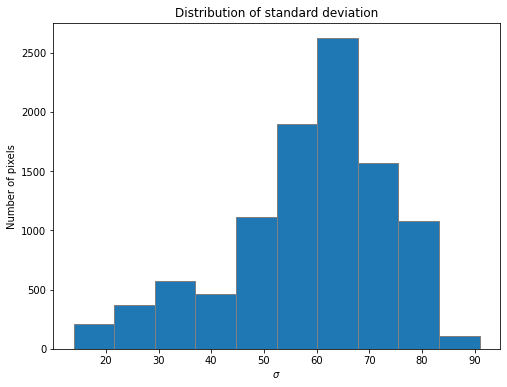

In [322]:
# Overall stddev distribution
all_imgs = brighter_images + darker_images + intermediate_images
stddev = []
for img in all_imgs:
    img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    stddev.append(np.std(img_hsv[..., 2]))

plt.figure(figsize=(8, 6))
plt.hist(stddev, edgecolor='gray')
plt.xlabel(r'$\sigma$')
plt.ylabel('Number of pixels')
plt.title('Distribution of standard deviation')
plt.show()

From the visual inspection of individual images, I find stddev of $\sim$ 50 can be a godd border between day/night images. It is also possible to separate images taken in bad weather conditions from sunny images among the bright images based on the stddev value. Moreover, combining median brightness with standard deviation likey enables me to build better criteria which tell weather conditions apart more accurately. But I don't dive deep into it now. 

One important finding I have obtained so far is that the numbers of images taken at night or in bad weather conditions are quite smaller than that of sunny images. I should keep it in mind when peforming data augmentation.

#### 3. Object Number/Density

It's good to know how dense traffic environment our target objects are in. That is, how many objects are there in an image and are they isolated from others or partially overlapping with each other? 

Median of the number of objects in an image is 18


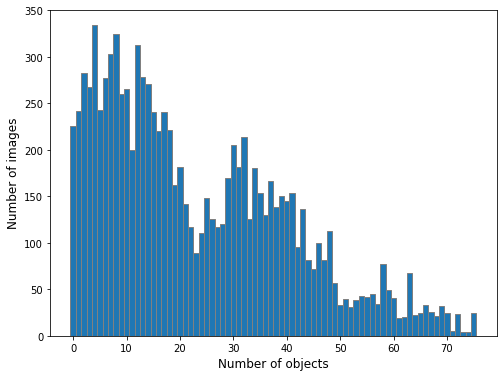

In [379]:
# Distribution of total number of objects in an image
N_obj = {0:[], 1:[], 2:[], 4:[]}  # in the order of Total, Vehicles, Pedestrians, and Cyclists
for data in dataset:
    gt_classes = data['groundtruth_classes'].numpy()
    N_obj[0].append(len(gt_classes))
    N_obj[1].append(np.count_nonzero(gt_classes == 1))
    N_obj[2].append(np.count_nonzero(gt_classes == 2))
    N_obj[4].append(np.count_nonzero(gt_classes == 4))

print(f'Median of the number of objects in an image is {np.median(N_obj[0]):.0f}')

plt.figure(figsize=(8, 6))
total_hist, total_bins, _ = plt.hist(N_obj[0], bins=range(0, max(N_obj[0])+1, 1), edgecolor='gray', align='left')
plt.xlabel('Number of objects', fontsize=12)
plt.ylabel('Number of images', fontsize=12)
plt.show()

As shown in the figure above, the number of objects in an image significantly varies among the images ranging from 0 to 76. The median value of 19 is quite large so I expect considerable overlaps of objects in the images, which will be further investigated later.

The composition of the distribution is worth examining too.

In [377]:
# Sort the lists in the ascent order with respect to the total number of objects.
sorted_idx = np.argsort(N_obj[0])
N_vehicle_sorted = np.array(N_obj[1])[sorted_idx]
N_pedestrian_sorted = np.array(N_obj[2])[sorted_idx]
N_cyclist_sorted = np.array(N_obj[4])[sorted_idx]

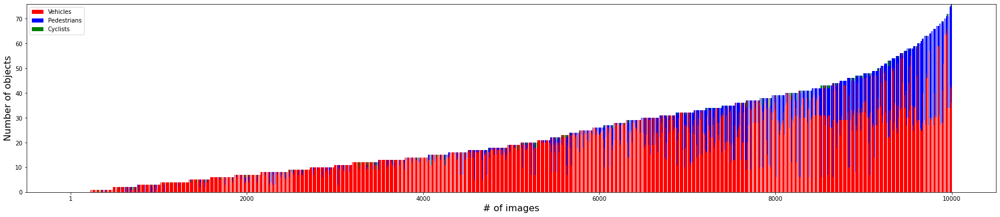

In [375]:
# Plot stacked bars showing contributions of each class.
plt.figure(figsize=(30,6))
plt.bar(range(1, 10001), N_vehicle_sorted, color='red', label='Vehicles')
plt.bar(range(1, 10001), N_pedestrian_sorted, bottom=N_vehicle_sorted, color='blue', label='Pedestrians')
plt.bar(range(1, 10001), N_cyclist_sorted, bottom=N_vehicle_sorted + N_pedestrian_sorted, color='green', label='Cyclists')
plt.xlabel('# of images', fontsize=16)
plt.ylabel('Number of objects', fontsize=16)
plt.xticks([1, 2000, 4000, 6000, 8000, 10000])
plt.legend(loc='upper left')
plt.show()

We can see that most of the objects in the data are vehicles and cyclists class is very rare as shown in the class distribution analysis. It is also interesting that the fraction of pedestrians gets higher as the total number of objects in an image increases, indicating that objects labeld as pedestrians are typically in dense environments.

Next I invesigate how the objects overlap with each other using IoUs.

In [5]:
def calc_iou(bbox1, bbox2):
    """Calculate IoU of two bounding boxes
    args:
        - bbox1 [list]: Normalized coordinates which define a bounding box, [y1, x1, y2, x2]
        - bbox2 [list]: Same as bbox1, but represented by [w1, v1, w2, v2]
    returns:
        - iou [float]: IoU of bbox1 and bbox2 within a range of [0, 1]
    """
    # Expand the inputs.
    y1, x1, y2, x2 = bbox1
    w1, v1, w2, v2 = bbox2
    A = (x2-x1)*(y2-y1)
    B = (v2-v1)*(w2-w1)

    # Get edges of the intersection.
    xmin = max(x1, v1)
    ymin = max(y1, w1)
    xmax = min(x2, v2)
    ymax = max(y2, w2)

    # Calculate the IoU considering that there is no overlap if either (xmax-xmin) or (ymax-ymin) is negative.
    intersection = max(xmax-xmin, 0) * max(ymax-ymin, 0)
    union = A + B - intersection
    iou = intersection / union

    return iou

def mean_iou(boxes):
    """Calculate mean IoU over all objects in the image.
    args:
        - boxes [list[list]]: List of bounding boxes
    returns:
        - iou [float]: IoU averaged over the objects.
    """
    if len(boxes) == 0:
        return None
        
    iou_sum = 0
    for i, box in enumerate(boxes):
        for other in boxes[i+1:]:
            iou_sum += calc_iou(box, other)
    
    return iou_sum / len(boxes)

In [6]:
# Calculate mean IoUs for all images and sort them based on the number of objects in each image.
ious = {i:[] for i in range(77)}
for data in dataset:
    gt_boxes = data['groundtruth_boxes'].numpy()
    iou = mean_iou(gt_boxes)
    if iou is not None:
        ious[len(gt_boxes)].append(iou)

/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:233: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:194: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:43: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims, initial, where)

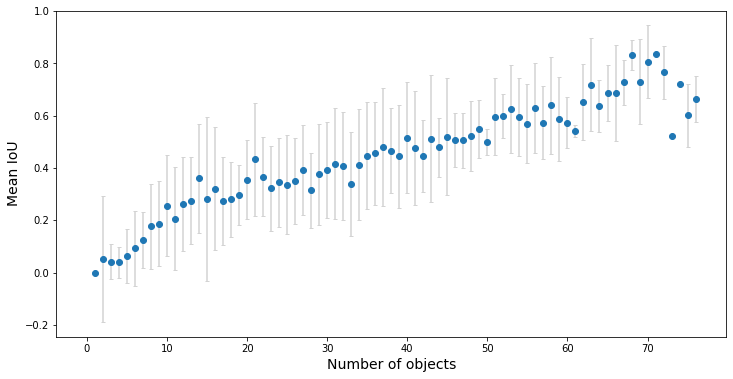

In [42]:
# Plot the mean IoU as a function of the number of objects in an image.
N_obj = list(ious.keys())
mean_iou = [np.mean(iou) for iou in ious.values()]
stddev = [np.std(iou) for iou in ious.values()]

plt.figure(figsize=(12, 6))
plt.scatter(N_obj, mean_iou, zorder=2)
plt.errorbar(N_obj, mean_iou, yerr=stddev, fmt='none', ecolor='lightgray', capsize=2, zorder=1)
plt.xlabel('Number of objects', fontsize=14)
plt.ylabel('Mean IoU', fontsize=14)
plt.show()

As expected, mean IoU of an image becomes larger as the number of objects in it increases. Images containing 19 objects, which is the median among all images, have mean IoU of $\sim$ 0.3 on average. I haven't understood how such overlaps affect difficulty to achieve good detection performance, but will keep it in mind when training the model.

The function below visualizes individual images filterd by the number of objects. It is useful to see how the density of each image look like.

In [78]:
def show_N_objects(dataset, N=0, batch_size=14):
    def select_dataset(data):
        gt_classes = data['groundtruth_classes']
        num_obj = len(gt_classes)
        if num_obj == N:
            return True
        else:
            return False
    new_dataset = dataset.filter(select_dataset)
    batch = new_dataset.shuffle(buffer_size=100).take(batch_size)
    display_instances(batch)
    

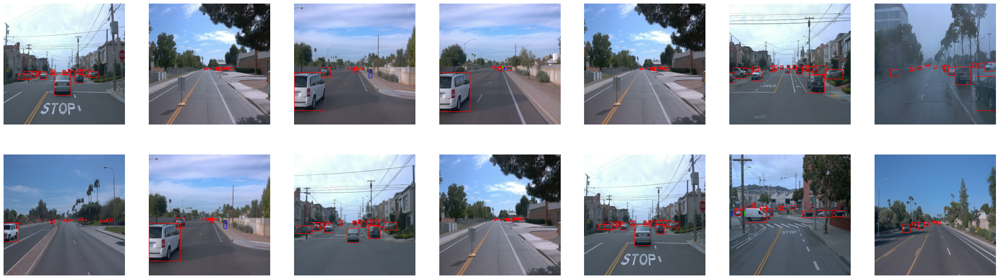

In [83]:
show_N_objects(dataset, N=19)

### Object size distribution

With the visualization of individual images, it is obvious that sizes of objects (bounding boxes) significantly vary among them. There are large amount of so small objects that I cannot tell what classes they belong to without ground truth information. I wonder if the model achieve good peformance even for such small objects. It would be necessary to come up with a good strategy for the training.